#SAM for colab

colab setting

In [ ]:
using_colab = True

In [ ]:
if using_colab:
    import torch
    import torchvision
    print("PyTorch version:", torch.__version__)
    print("Torchvision version:", torchvision.__version__)
    print("CUDA is available:", torch.cuda.is_available())
    import sys
    !{sys.executable} -m pip install opencv-python matplotlib
    !{sys.executable} -m pip install 'git+https://github.com/facebookresearch/segment-anything.git'

    !mkdir images
    !wget -P images https://raw.githubusercontent.com/facebookresearch/segment-anything/main/notebooks/images/dog.jpg

    !wget https://dl.fbaipublicfiles.com/segment_anything/sam_vit_h_4b8939.pth

PyTorch version: 2.6.0+cu124
Torchvision version: 0.21.0+cu124
CUDA is available: False
  Cloning https://github.com/facebookresearch/segment-anything.git to /tmp/pip-req-build-c3azltfw
  Running command git clone --filter=blob:none --quiet https://github.com/facebookresearch/segment-anything.git /tmp/pip-req-build-c3azltfw
  Resolved https://github.com/facebookresearch/segment-anything.git to commit dca509fe793f601edb92606367a655c15ac00fdf
  Preparing metadata (setup.py) ... done
  Created wheel for segment_anything: filename=segment_anything-1.0-py3-none-any.whl size=36592 sha256=087ee22115ff721760e471d2343debb53699c11f5e3719169f16946b9dd976e7
  Stored in directory: /tmp/pip-ephem-wheel-cache-am8ctjdu/wheels/15/d7/bd/05f5f23b7dcbe70cbc6783b06f12143b0cf1a5da5c7b52dcc5
Successfully built segment_anything
--2025-03-26 08:47:27--  https://raw.githubusercontent.com/facebookresearch/segment-anything/main/notebooks/images/dog.jpg
Resolving raw.githubusercontent.com (raw.githubusercontent.co

import and show marged_image function

In [ ]:
import numpy as np
import torch
import matplotlib.pyplot as plt
import cv2

In [ ]:
def show_anns(anns):
    if len(anns) == 0:
        return
    sorted_anns = sorted(anns, key=(lambda x: x['area']), reverse=True) #ordina le maschere per ordine di area
    ax = plt.gca()
    ax.set_autoscale_on(False)

    img = np.ones((sorted_anns[0]['segmentation'].shape[0], sorted_anns[0]['segmentation'].shape[1], 4)) #crea immagine RGBA trasparente
    img[:,:,3] = 0
    for ann in sorted_anns:
        m = ann['segmentation']
        color_mask = np.concatenate([np.random.random(3), [0.35]]) #colore casuale per ogni maschera più trasparenza
        img[m] = color_mask
    ax.imshow(img)

Load and image statistic

In [ ]:
image = cv2.imread('/content/201812_cropped_exg_normalized.png') # da modificare con la propria immagine
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

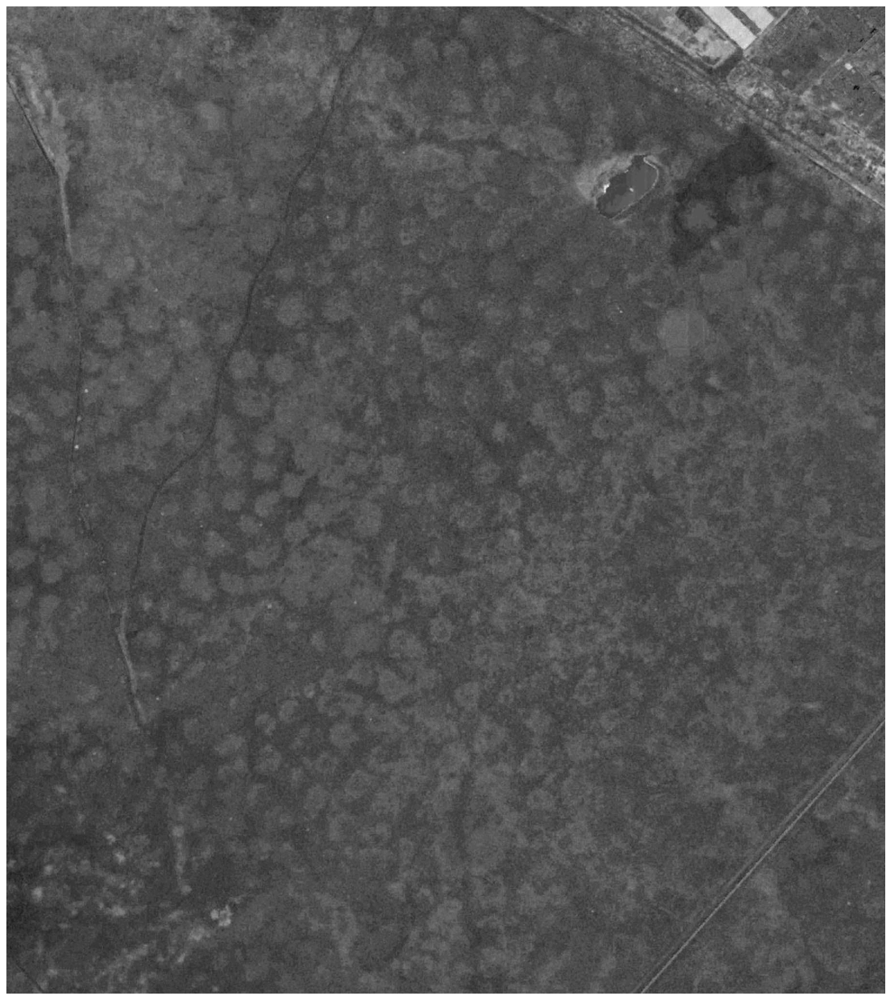

In [ ]:
plt.figure(figsize=(20,20))
plt.imshow(image)
plt.axis('off')
plt.show()

In [ ]:
# Ottieni altezza e larghezza
height, width, _ = image.shape

print(f"Larghezza: {width} px, Altezza: {height} px")

# OSSERVAZIONE: Nel caso di immagini satellitari, ho un rettangolo di cui posso calcolare base e altezza, nel caso di immagine mediche non saprei..
# Dimensioni reali dell'immagine (in metri)
real_width_m = 2050
real_height_m = 2430

# Risoluzione (m/pixel)
res_x = real_width_m / width
res_y = real_height_m / height

print(f"Risoluzione: {res_x:.3f} m/pixel (orizzontale), {res_y:.3f} m/pixel (verticale)")

# Media delle risoluzioni per ottenere la media m/pixel
res_avg = (res_x + res_y) / 2
print(f"Risoluzione media: {res_avg:.3f} m/pixel)")

Larghezza: 3650 px, Altezza: 4100 px
Risoluzione: 0.562 m/pixel (orizzontale), 0.593 m/pixel (verticale)
Risoluzione media: 0.577 m/pixel)


In [ ]:
# Ridimensionare l'immagine
scale_percent = 20
width = int(image.shape[1] * scale_percent / 100)
height = int(image.shape[0] * scale_percent / 100)
image_resized = cv2.resize(image, (width, height), interpolation=cv2.INTER_AREA)

SAM model load

In [ ]:
import sys
sys.path.append("..")
from segment_anything import sam_model_registry, SamAutomaticMaskGenerator, SamPredictor

sam_checkpoint = "sam_vit_h_4b8939.pth"
model_type = "vit_h"

if torch.cuda.is_available():
  device = "cuda"
else:
  device = "cpu"

sam = sam_model_registry[model_type](checkpoint=sam_checkpoint)
sam.to(device=device)

mask_generator = SamAutomaticMaskGenerator(sam)

**default model**

In [ ]:
masks_default = mask_generator.generate(image_resized)

In [ ]:
print(len(masks_default))
print(masks_default[0].keys())
print(type(masks_default))

92
dict_keys(['segmentation', 'area', 'bbox', 'predicted_iou', 'point_coords', 'stability_score', 'crop_box'])
<class 'list'>


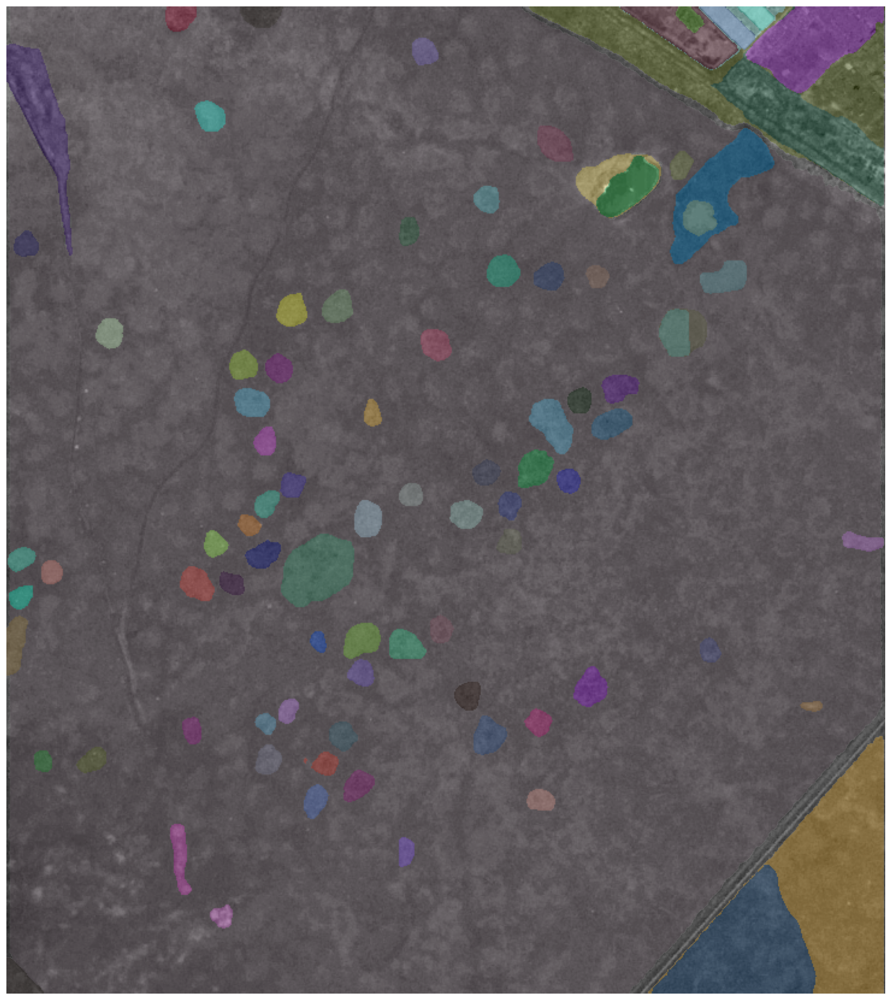

In [ ]:
plt.figure(figsize=(20,20))
plt.imshow(image_resized)
show_anns(masks_default)
plt.axis('off')
plt.show()

**customised model**
There are several tunable parameters in automatic mask generation that control how densely points are sampled and what the thresholds are for removing low quality or duplicate masks. Additionally, generation can be automatically run on crops of the image to get improved performance on smaller objects, and post-processing can remove stray pixels and holes. Here is an example configuration that samples more masks:

In [ ]:
mask_generator_2 = SamAutomaticMaskGenerator(
    model=sam,
    points_per_side=32,
    pred_iou_thresh=0.8,
    stability_score_thresh=0.9,
    crop_n_layers=1,
    crop_n_points_downscale_factor=2,
    min_mask_region_area=100,  # Requires open-cv to run post-processing
)

In [ ]:
masks2 = mask_generator_2.generate(image_resized)

In [ ]:
len(masks2)

185

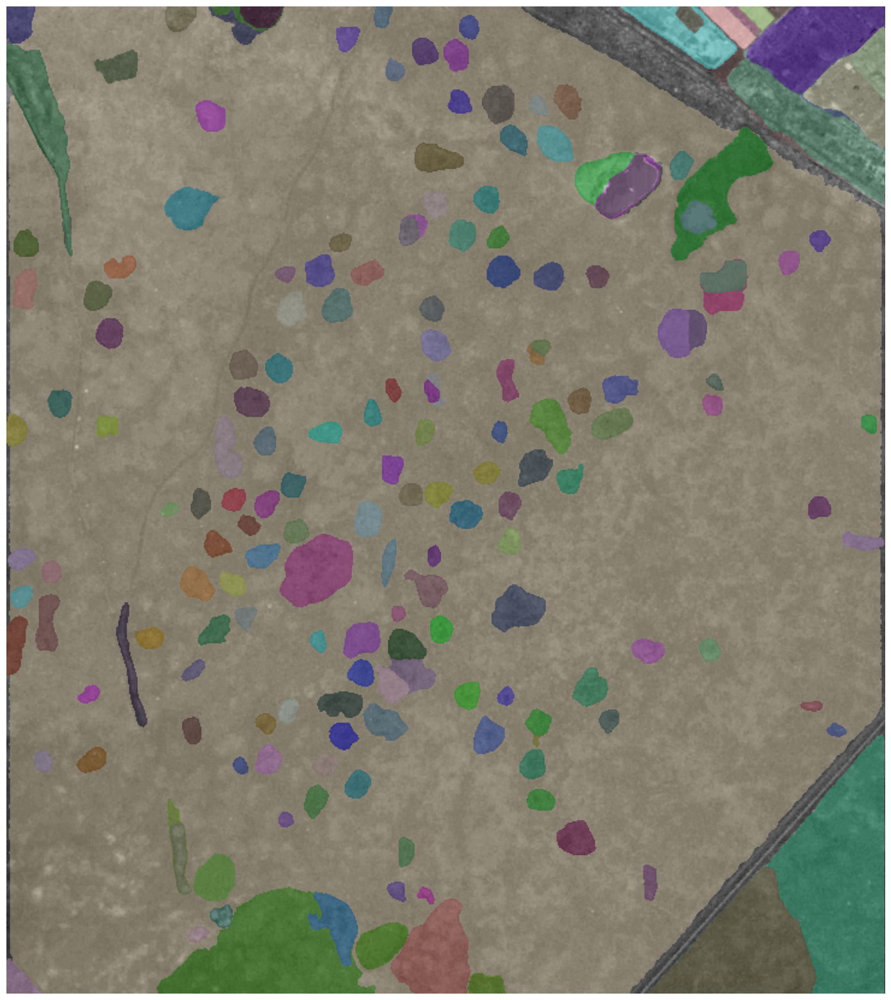

In [ ]:
plt.figure(figsize=(20,20))
plt.imshow(image_resized)
show_anns(masks2)
plt.axis('off')
plt.show()



---



---


**Serializzazione delle maschere**

Ad ogni maschera generata da SAM viene associato un ID. Gli identificativi sono numeriin ordine crescente a partire da 000. Ogni maschera viene identificata con un numero subito dopo la segmentazione e prima di applicare i filtri desiderati, ciò servirà per tenere traccia della maschera nella pipeline implementata.


---



---



In [ ]:
# Aggiunta dell'ID a ciascuna maschera
for i, mask in enumerate(masks_default):
    mask["id"] = f"{i:03d}"  # formato '000', '001', ..., '999'

In [ ]:
print(masks_default[0].keys())

dict_keys(['segmentation', 'area', 'bbox', 'predicted_iou', 'point_coords', 'stability_score', 'crop_box', 'id'])


#Salvataggio pkl di tutte le mashcere

In [ ]:
import pickle

with open('masks_sam_raw.pkl', 'wb') as f: #cambiare il nome in base alla tipologia di maschere
    pickle.dump(masks_default, f)

#visualizzazione bbox

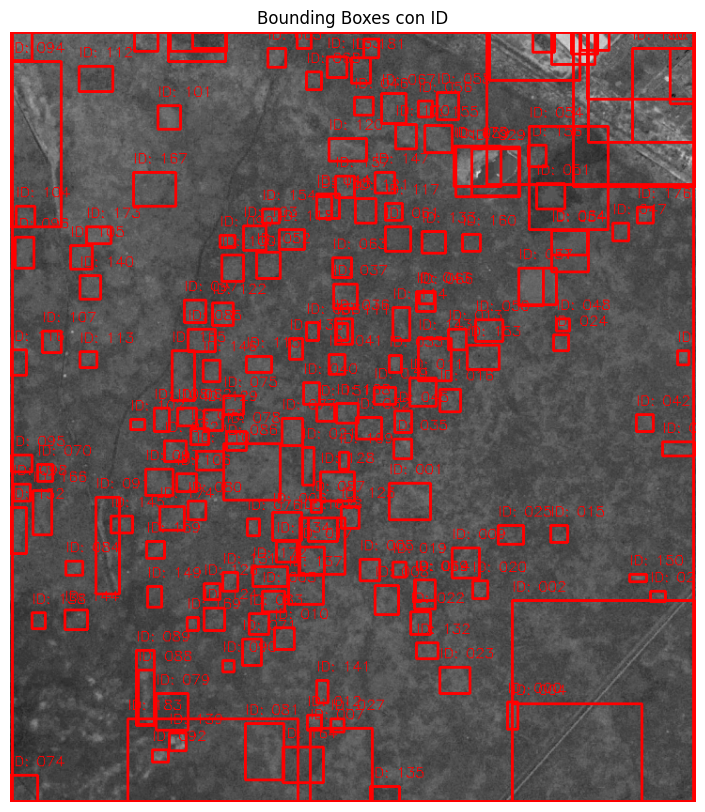

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Copia dell'immagine originale su cui disegnare (convertita in RGB se necessario)
image_with_boxes = image_resized.copy()

# Se serve: image_resized = cv2.cvtColor(image_resized, cv2.COLOR_BGR2RGB)

for mask in masks2:
    mask_id = mask["id"]
    x, y, w, h = mask["bbox"]  # Bounding box: x, y, width, height

    # Disegna la bounding box
    cv2.rectangle(image_with_boxes, (x, y), (x + w, y + h), color=(255, 0, 0), thickness=2)

    # Aggiungi il testo con l'ID sopra la box
    cv2.putText(image_with_boxes, f"ID: {mask_id}", (x, y - 10),
                fontFace=cv2.FONT_HERSHEY_SIMPLEX, fontScale=0.5,
                color=(255, 0, 0), thickness=1)

# Visualizza il risultato
plt.figure(figsize=(10, 10))
plt.imshow(image_with_boxes)
plt.axis('off')
plt.title("Bounding Boxes con ID")
plt.show()

In [ ]:
!pip install -q supervision jupyter_bbox_widget

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 181.5/181.5 kB 13.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 220.7/220.7 kB 16.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 765.5/765.5 kB 37.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 56.1 MB/s eta 0:00:00


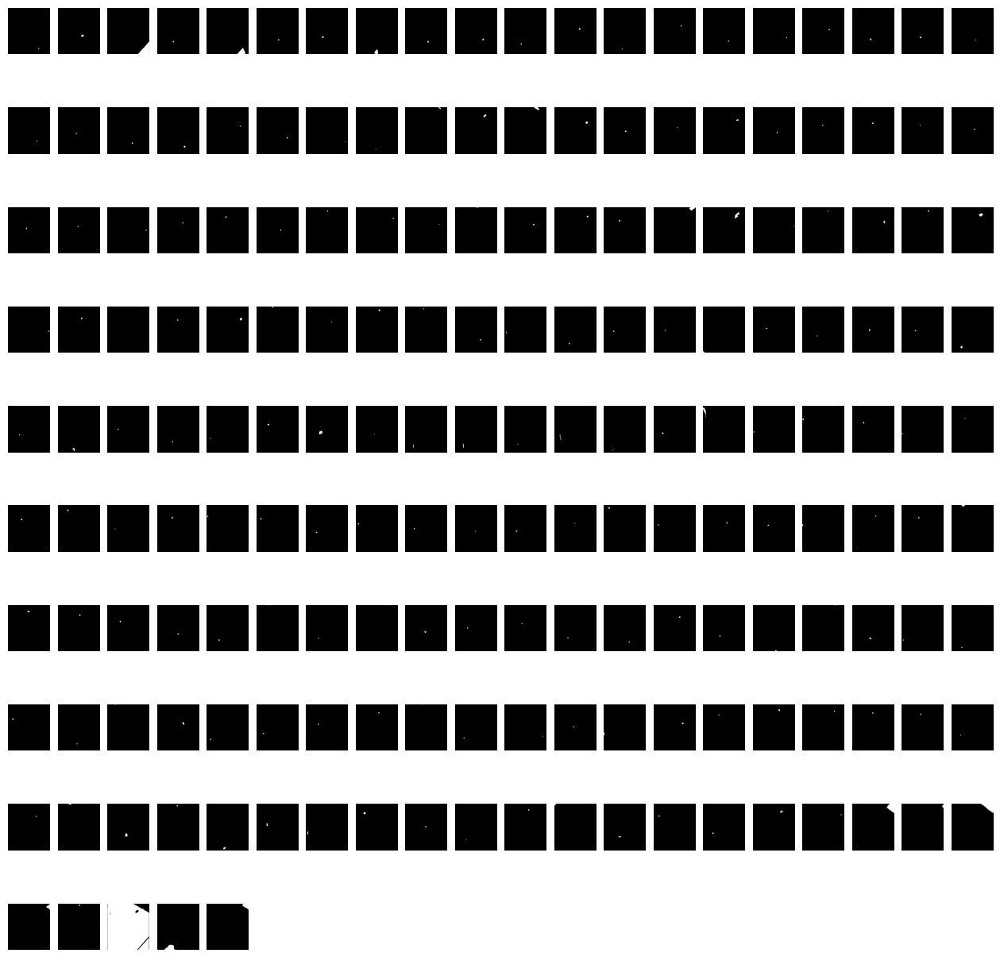

In [ ]:
import supervision as sv
masks_seg = [mask['segmentation'] for mask in masks2]
sv.plot_images_grid(images=masks_seg, grid_size=(10, int(len(masks_seg)/9)), size=(16,16))

#Filtro stability



---



---


**Funzione per filtrare le maschere ottenute dopo la funzione .generate()**


Prende in input la lista di maschere masks generata da SAM.
Applica un filtro basato su:


*  predicted_iou > 0.85
*  stability_score > 0.9



Restituisce solo le maschere che soddisfano entrambi i criteri.



---



---



In [ ]:
def filter_high_quality_masks(masks, iou_threshold=0.87, stability_threshold=0.95):
    """
    Filtra le maschere di SAM in base ai valori di predicted_iou e stability_score.

    Args:
        masks (list): Lista di dizionari contenenti le maschere generate da SAM.
        iou_threshold (float): Soglia minima per predicted_iou.
        stability_threshold (float): Soglia minima per stability_score.

    Returns:
        list: Lista delle maschere che superano le soglie di qualità.
    """
    high_quality_masks = [
        mask for mask in masks
        if mask["predicted_iou"] > iou_threshold and mask["stability_score"] > stability_threshold
    ]
    return high_quality_masks

In [ ]:
# Esempio di utilizzo:
# Supponiamo di avere una lista di maschere chiamata `masks`
filtered_masks = filter_high_quality_masks(masks_default)

# Stampa il numero di maschere filtrate
print(f"Numero di maschere filtrate: {len(filtered_masks)}")

Numero di maschere filtrate: 92


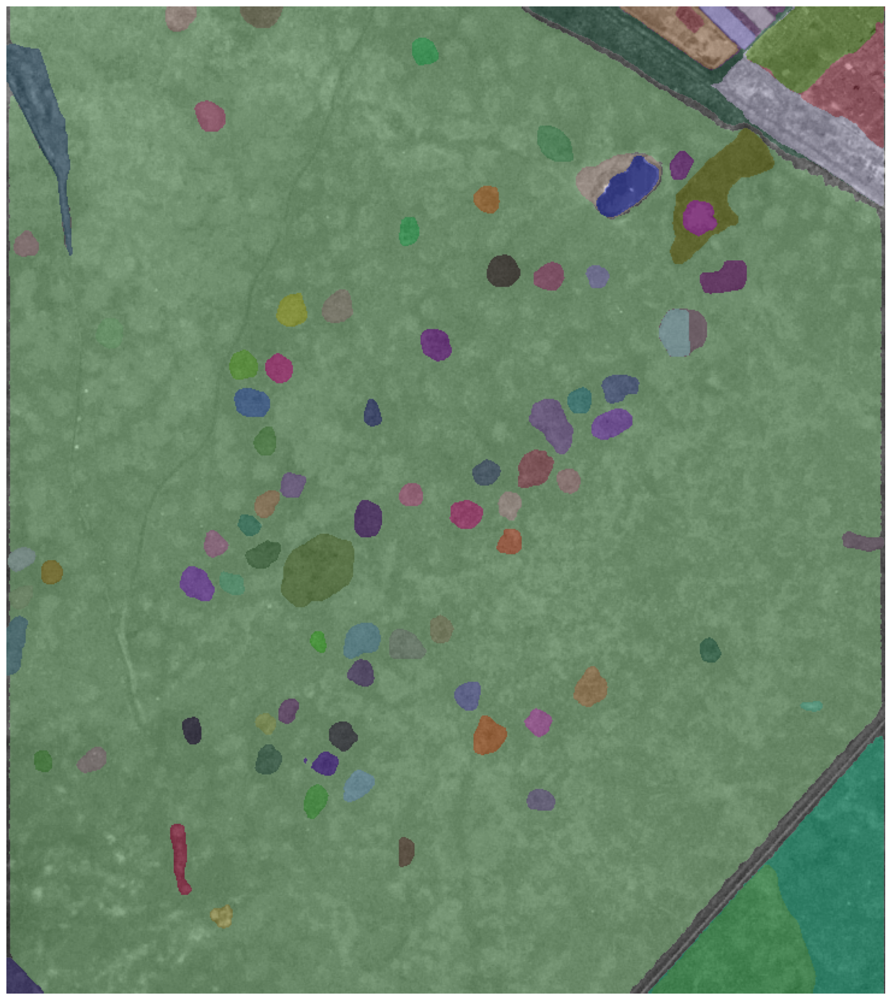

In [ ]:
plt.figure(figsize=(20,20))
plt.imshow(image_resized)
show_anns(filtered_masks)
plt.axis('off')
plt.show()



---



---


**Strategia per filtrare le maschere per area (in m^2 e in pixel)**

1. Calcolare la stima dell'area reale
2.   Definire un intervallo accettabile per l’area


*   Un valore minimo (min_area) per escludere maschere troppo piccole che potrebbero essere rumore.
*   Un valore massimo (max_area) per eliminare maschere troppo grandi che non rappresentano singoli fairy rings.
3.   Modificare la funzione di filtraggio per includere questo nuovo criterio.



---

---


Analisi delle aree: si stima per ogni maschera l'area reale.

In [ ]:
import numpy as np

def add_real_area_to_masks(masks, real_avg):
    """
    Aggiunge a ciascuna maschera una nuova chiave 'real_area' (in metri quadrati),
    calcolata sulla base dell'area in pixel e della risoluzione spaziale dell'immagine.
    """

    for mask in masks:
        pixel_area = mask.get('area', None)
        if pixel_area is not None:
            real_area = pixel_area * (res_avg ** 2)
            mask['real_area'] = real_area
        else:
            mask['real_area'] = None  # Nessuna area trovata

    return masks


In [ ]:
masks = add_real_area_to_masks(filtered_masks, res_avg)

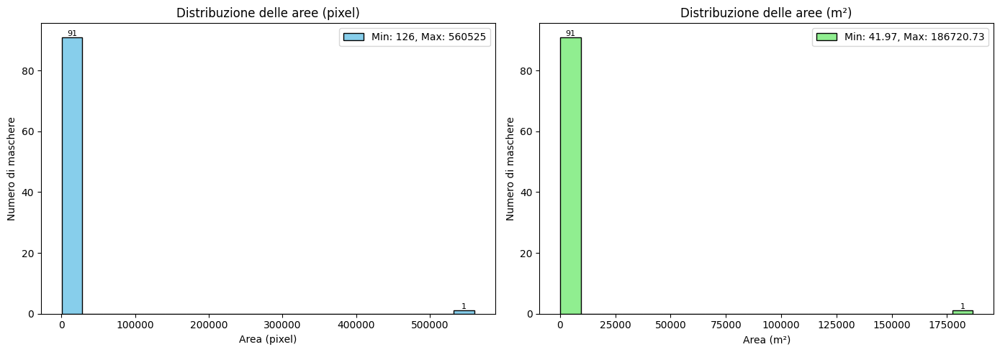

In [ ]:
import matplotlib.pyplot as plt

# Dati delle aree
areas_pixel = [mask["area"] for mask in filtered_masks]
areas_real = [mask["real_area"] for mask in filtered_masks]

# Calcolo min e max
min_pixel, max_pixel = min(areas_pixel), max(areas_pixel)
min_real, max_real = min(areas_real), max(areas_real)

# Creazione dei subplot
fig, axs = plt.subplots(1, 2, figsize=(14, 5))

# --- Istogramma delle aree in pixel ---
counts_pixel, bins_pixel, patches_pixel = axs[0].hist(areas_pixel, bins=20, color='skyblue', edgecolor='black')
axs[0].set_xlabel("Area (pixel)")
axs[0].set_ylabel("Numero di maschere")
axs[0].set_title("Distribuzione delle aree (pixel)")
axs[0].legend([f"Min: {min_pixel}, Max: {max_pixel}"], loc='upper right')

# Aggiunta delle etichette su ogni barra
for count, patch in zip(counts_pixel, patches_pixel):
    if count > 0:
        x = patch.get_x() + patch.get_width() / 2
        y = patch.get_height()
        axs[0].text(x, y, int(count), ha='center', va='bottom', fontsize=8)

# --- Istogramma delle aree in metri quadrati ---
counts_real, bins_real, patches_real = axs[1].hist(areas_real, bins=20, color='lightgreen', edgecolor='black')
axs[1].set_xlabel("Area (m²)")
axs[1].set_ylabel("Numero di maschere")
axs[1].set_title("Distribuzione delle aree (m²)")
axs[1].legend([f"Min: {min_real:.2f}, Max: {max_real:.2f}"], loc='upper right')

# Aggiunta delle etichette su ogni barra
for count, patch in zip(counts_real, patches_real):
    if count > 0:
        x = patch.get_x() + patch.get_width() / 2
        y = patch.get_height()
        axs[1].text(x, y, int(count), ha='center', va='bottom', fontsize=8)

plt.tight_layout()
plt.show()

**Osservazione:** l'analisi delle aree sarebbe bene farla prima o dopo il filtro per qualità?



---



---


**Automatizzazione della scelta dei valori di min e max area per pixel**


1.   quantile_range: perchè i quantili evitano soglie arbitrarie, funzionano bene con dati a distribuzione non gaussiana, è utile contro gli outlier.
2.   deviazione standard con moltiplicatori: quando i dati hanno una distribuzione simmetrica ed è utile per ragionare in termini di distaza dalla media, permette così di identificare valori anomali.
3. range fisso: quando gli altri due metodi non sembrano essere utili, allora è possibile selezionare a mano i valori di min e max area (in pixel) aiutandosi con il grafico precedente.


---



---



In [ ]:
def auto_filter_masks(masks, area_key="area",  # oppure "real_area"
    method="quantile",
    quantile_range=(5, 95),
    std_multiplier=1,
    fixed_range=(10, 1000),
    plot=False,
    method_name=None
):
    """
    Filtra automaticamente le maschere in base all'area in pixel o real_area,
    scegliendo il metodo di soglia tra: 'quantile', 'std', 'fixed'.

    Parametri:
    - masks: lista di dizionari con chiave 'area'
    - method: 'quantile', 'std' o 'fixed'
    - quantile_range: tuple (min%, max%) per il metodo quantile
    - std_multiplier: numero di deviazioni standard da usare per il metodo 'std'
    - fixed_range: tuple (min_area, max_area) da usare per 'fixed'
    - plot: se True, mostra l'istogramma con le soglie evidenziate

    Ritorna:
    - lista di maschere filtrate
    - tuple (min_area, max_area) usate nel filtro
    """
    import numpy as np
    import matplotlib.pyplot as plt

    # Estrai i valori da filtrare
    areas = [mask[area_key] for mask in masks if mask.get(area_key) is not None]

    # Calcolo delle soglie
    if method == "quantile":
        min_area = np.percentile(areas, quantile_range[0])
        max_area = np.percentile(areas, quantile_range[1])
        method_name = method_name or f"Quantile ({quantile_range[0]}–{quantile_range[1]})"
    elif method == "std":
        mean = np.mean(areas)
        std = np.std(areas)
        min_area = mean - std_multiplier * std
        max_area = mean + std_multiplier * std
        method_name = method_name or f"Media ± {std_multiplier}σ"
    elif method == "fixed":
        min_area, max_area = fixed_range
        method_name = method_name or f"Range fisso [{min_area}, {max_area}]"
    else:
        raise ValueError("Metodo non valido. Usa 'quantile', 'std' o 'fixed'.")

    # Filtro effettivo
    filtered_masks = [
        mask for mask in masks
        if mask.get(area_key) is not None and min_area <= mask[area_key] <= max_area
    ]

    # Istogramma con evidenziazione, se richiesto
    if plot:
        plt.figure(figsize=(8, 4))
        counts, bins, _ = plt.hist(areas, bins=30, color='lightgrey', edgecolor='black', label="Tutte le maschere")
        # Evidenzia l'intervallo desiderato
        plt.axvspan(min_area, max_area, color='lightgreen', alpha=0.4, label="Range selezionato")
        # Linee verticali sulle soglie
        plt.axvline(min_area, color='red', linestyle='--', label=f"Min: {min_area:.2f}")
        plt.axvline(max_area, color='green', linestyle='--', label=f"Max: {max_area:.2f}")
        plt.xlabel(f"Area ({'m²' if area_key == 'real_area' else 'pixel'})")
        plt.ylabel("Masks Numbers")
        plt.title(f"Area Distribution – Method: {method_name}")
        plt.legend()
        plt.tight_layout()
        plt.show()

    return filtered_masks, (min_area, max_area)

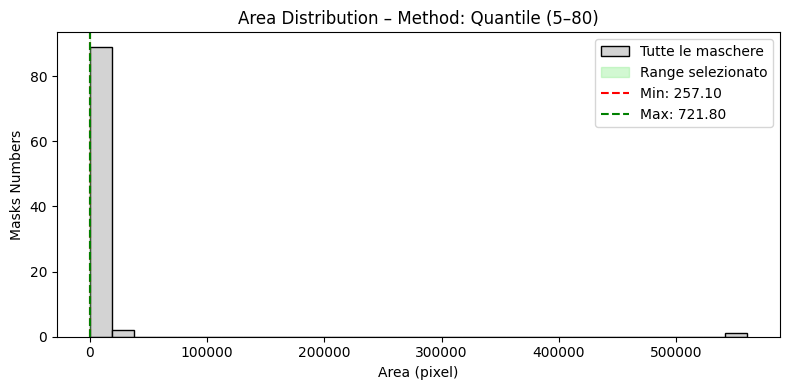

Numero di maschere filtrate: 68


In [ ]:
# prova con metodo quantile
filtered_by_autom_pixel_areamasks, (min_a_pixel, max_a_pixel) = auto_filter_masks(masks, area_key="area", method="quantile", quantile_range=(5, 80), plot=True)

# prova con deviazione standard
#filtered_by_autom_pixel_areamasks, _ = auto_filter_masks(masks, method="std", std_multiplier=1, plot=True)

# prova con range fisso
#filtered_by_autom_pixel_areamasks, _ = auto_filter_masks(masks, method="fixed", fixed_range=(200, 800), plot=True)

# Stampa il numero di maschere filtrate
print(f"Numero di maschere filtrate: {len(filtered_by_autom_pixel_areamasks)}")

**Comparison: pixel vs meter**

Se aggiungessimo al nostro insieme di configurazione una chiave per indicare che si vogliono configurare i filtri di area pixel e metri, allora si può richiamare la funzione sottostante!!

Per esempio:


-File di config: compare=True
-File con funzioni filtri:


---



---
[some code ...]
if comparison: compare_area_filters_on_masks(
    masks,
    image_resized,
    quantile_range=(5, 95)
)
  [some code ...]


In [ ]:
import matplotlib.pyplot as plt

def compare_area_filters_on_masks(
    masks,
    image_resized,
    quantile_range=(5, 95)
):
    """
    Applica il filtro automatico per quantili sia su 'area' che 'real_area',
    e mostra le due segmentazioni affiancate sull'immagine originale.
    """
    # Filtro per area in pixel
    filtered_pixel_masks, (min_p, max_p) = auto_filter_masks(
        masks, method="quantile", area_key="area", quantile_range=quantile_range
    )

    # Filtro per area in m²
    filtered_real_masks, (min_r, max_r) = auto_filter_masks(
        masks, method="quantile", area_key="real_area", quantile_range=quantile_range
    )

    # Visualizzazione affiancata
    fig, axs = plt.subplots(1, 2, figsize=(20, 20))

    # SINISTRA: area in pixel
    plt.sca(axs[0])
    axs[0].imshow(image_resized)
    show_anns(filtered_pixel_masks)
    axs[0].axis('off')
    axs[0].set_title(f"Filter with Pixel Area\n({min_p:.0f} – {max_p:.0f} px)", fontsize=14)

    # DESTRA: area in m²
    plt.sca(axs[1])
    axs[1].imshow(image_resized)
    show_anns(filtered_real_masks)
    axs[1].axis('off')
    axs[1].set_title(f"Filter with Real Area\n({min_r:.2f} – {max_r:.2f} m²)", fontsize=14)

    plt.tight_layout()
    plt.show()

    return filtered_pixel_masks, filtered_real_masks

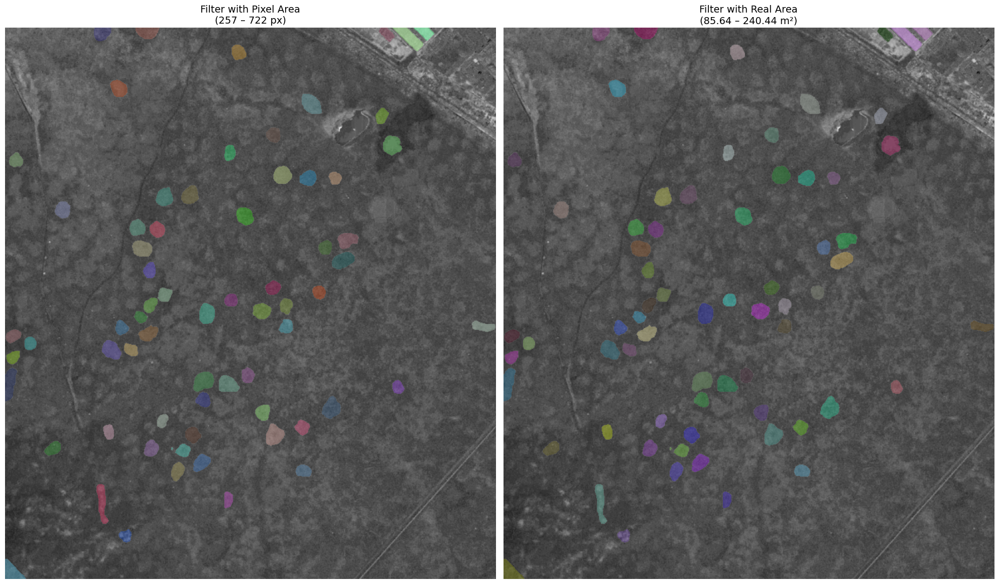

In [ ]:
filtered_px, filtered_m2 = compare_area_filters_on_masks(masks, image_resized, quantile_range=(5, 80))

#Dashboard per impostare metodo e valori

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import ipywidgets as widgets
from IPython.display import display, clear_output

saved_configs = []  # per salvare i parametri che soddisfano

def full_mask_dashboard(masks, image_resized):

    # Widget per scelta metodo
    method_dropdown = widgets.Dropdown(
        options=['quantile', 'std', 'fixed'],
        value='quantile',
        description='Method:',
        style={'description_width': 'initial'}
    )

    # Widget per quantili
    min_q_slider = widgets.IntSlider(value=5, min=0, max=50, step=1, description='Min %')
    max_q_slider = widgets.IntSlider(value=95, min=50, max=100, step=1, description='Max %')

    # Widget per std multiplier
    std_slider = widgets.FloatSlider(value=1.0, min=0.1, max=3.0, step=0.5, description='±σ Mult.')

    # Widget per range fisso
    fixed_min_area = widgets.FloatText(value=50, description='Min area (m²)')
    fixed_max_area = widgets.FloatText(value=500, description='Max area (m²)')

    # Bottone per salvare i parametri
    save_button = widgets.Button(description="Save Configuration", button_style='success')

    output = widgets.Output()

    def update_visualization(*args):
        with output:
            clear_output(wait=True)
            method = method_dropdown.value

            # Costruisci kwargs per la funzione auto_filter_masks
            if method == 'quantile':
                q_range = (min_q_slider.value, max_q_slider.value)
                filtered_px, (min_p, max_p) = auto_filter_masks(masks, method='quantile', area_key='area', quantile_range=q_range)
                filtered_m2, (min_r, max_r) = auto_filter_masks(masks, method='quantile', area_key='real_area', quantile_range=q_range)
                label_px = f"{min_p:.0f}–{max_p:.0f} px"
                label_m2 = f"{min_r:.2f}–{max_r:.2f} m²"

            elif method == 'std':
                std_val = std_slider.value
                filtered_px, (min_p, max_p) = auto_filter_masks(masks, method='std', area_key='area', std_multiplier=std_val)
                filtered_m2, (min_r, max_r) = auto_filter_masks(masks, method='std', area_key='real_area', std_multiplier=std_val)
                label_px = f"{min_p:.0f}–{max_p:.0f} px"
                label_m2 = f"{min_r:.2f}–{max_r:.2f} m²"

            elif method == 'fixed':
                fixed_range = (fixed_min_area.value, fixed_max_area.value)
                filtered_px, (min_p, max_p) = auto_filter_masks(masks, method='fixed', area_key='area', fixed_range=fixed_range)
                filtered_m2, (min_r, max_r) = auto_filter_masks(masks, method='fixed', area_key='real_area', fixed_range=fixed_range)
                label_px = f"{min_p:.0f}–{max_p:.0f} px"
                label_m2 = f"{min_r:.2f}–{max_r:.2f} m²"

            # Visualizzazione affiancata
            fig, axs = plt.subplots(1, 2, figsize=(20, 20))

            # Plot pixel
            plt.sca(axs[0])
            axs[0].imshow(image_resized)
            show_anns(filtered_px)
            axs[0].axis('off')
            axs[0].set_title(f"Area Filter (pixel)\n{label_px}", fontsize=14)

            # Plot m²
            plt.sca(axs[1])
            axs[1].imshow(image_resized)
            show_anns(filtered_m2)
            axs[1].axis('off')
            axs[1].set_title(f"Area Filter (m²)\n{label_m2}", fontsize=14)

            plt.tight_layout()
            plt.show()

            # Statistiche
            print(f"Number of Filtered Masks (pixel): {len(filtered_px)}")
            print(f"Number of Filtered Masks (m²):    {len(filtered_m2)}")

    def save_current_configuration(button):
        method = method_dropdown.value
        config = {'method': method}

        if method == 'quantile':
            config['quantile_range'] = (min_q_slider.value, max_q_slider.value)
        elif method == 'std':
            config['std_multiplier'] = std_slider.value
        elif method == 'fixed':
            config['fixed_range'] = (fixed_min_area.value, fixed_max_area.value)

        saved_configs.append(config)
        print("Configurazione salvata:", config)

    # Collega gli eventi
    method_dropdown.observe(update_visualization, names='value')
    min_q_slider.observe(update_visualization, names='value')
    max_q_slider.observe(update_visualization, names='value')
    std_slider.observe(update_visualization, names='value')
    fixed_min_area.observe(update_visualization, names='value')
    fixed_max_area.observe(update_visualization, names='value')
    save_button.on_click(save_current_configuration)

    # Layout dinamico in base al metodo
    def display_widgets_for_method(change):
        method = method_dropdown.value
        if method == 'quantile':
            controls.children = [min_q_slider, max_q_slider]
        elif method == 'std':
            controls.children = [std_slider]
        elif method == 'fixed':
            controls.children = [fixed_min_area, fixed_max_area]

        update_visualization()

    controls = widgets.VBox()
    display_widgets_for_method(None)
    method_dropdown.observe(display_widgets_for_method, names='value')

    display(widgets.VBox([
        method_dropdown,
        controls,
        save_button,
        output
    ]))

In [ ]:
full_mask_dashboard(masks, image_resized)

✅ Configurazione salvata: {'method': 'quantile', 'quantile_range': (10, 65)}


#Filtri area che possiamo eliminare
**applicazione dei filtri di area per pixel e stima reale in m^2**

In [ ]:
# se scegliamo la funzione con il settaggio automatico dei valori di area in pixel allora si può non considerare più questa funzione filtr.
def filter_masks_by_pixel_area(masks, min_area, max_area):
    """
    Filtra le maschere in base all'area inpixel.
    """
    filtered_masks = [
        mask for mask in masks
        if min_area <= mask["area"] <= max_area
    ]
    return filtered_masks

# Esempio di utilizzo:
filtered_pixel_area_masks = filter_masks_by_pixel_area(filtered_masks, min_area=10, max_area=1000)

# Stampa il numero di maschere rimaste dopo il filtro per area
print(f"Maschere dopo il filtro per area in pixel: {len(filtered_pixel_area_masks)}")

In [ ]:
def filter_masks_by_real_area(masks, min_area, max_area):
    """
    Filtra le maschere in base all'area stimata in m^2
    """
    filtered_masks = [
        mask for mask in masks
        if min_area <= mask["real_area"] <= max_area
    ]
    return filtered_masks

In [ ]:
# Esempio di utilizzo:
filtered_real_area_masks = filter_masks_by_real_area(filtered_masks, min_area=4, max_area=1000)

# Stampa il numero di maschere rimaste dopo il filtro per area
print(f"Maschere dopo il filtro per area in m^2: {len(filtered_real_area_masks)}")

Maschere dopo il filtro per area in m^2: 48


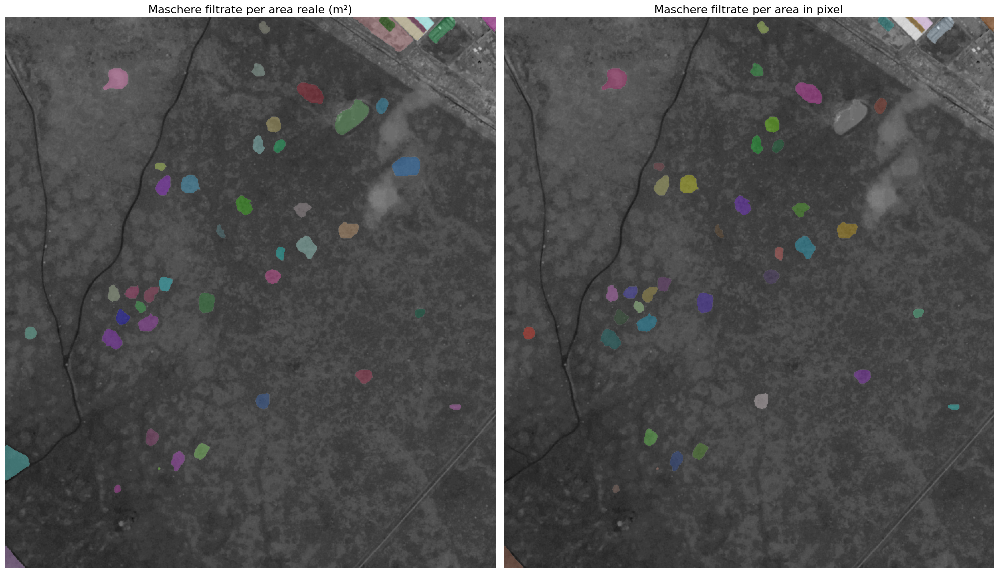

In [ ]:
import matplotlib.pyplot as plt

# Crea due subplot affiancati
fig, axs = plt.subplots(1, 2, figsize=(20, 20))

# --- SINISTRA: maschere filtrate per area reale ---
plt.sca(axs[0])  # imposta axs[0] come "current axis"
axs[0].imshow(image_resized)
show_anns(filtered_real_area_masks)
axs[0].axis('off')
axs[0].set_title("Maschere filtrate per area reale (m²)", fontsize=16)

# --- DESTRA: maschere filtrate per area in pixel ---
plt.sca(axs[1])  # imposta axs[1] come "current axis"
axs[1].imshow(image_resized)
show_anns(filtered_pixel_area_masks)
axs[1].axis('off')
axs[1].set_title("Maschere filtrate per area in pixel", fontsize=16)

plt.tight_layout()
plt.show()


**Risultato:** da notare il triangolo in basso a sinistra. con il filtro per area reale e in pixel viene conservato come maschera ma la prossima funzione, quella di roundness, farà in modo che tale triangolo venga scartato.


---
**Problema: ** nessuna funzione riesce però a scartare il rettangolo in alto a destra.


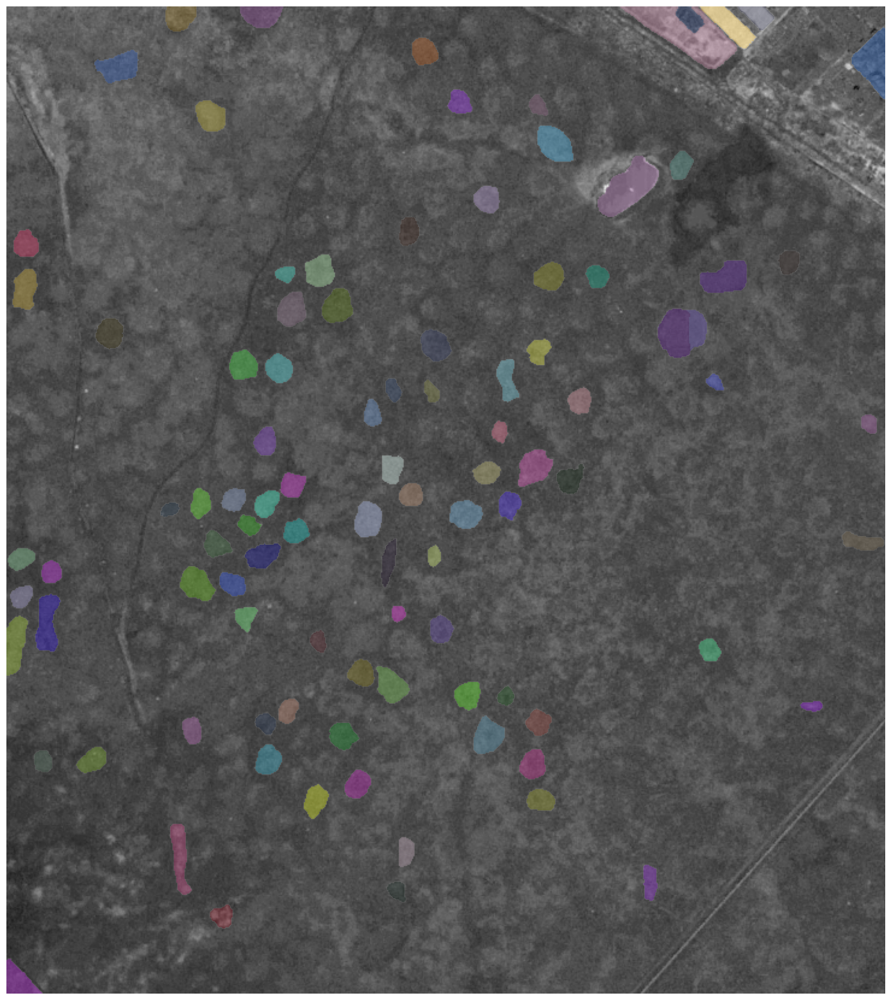

In [ ]:
# Per visualizzare una sola delle due immagini
plt.figure(figsize=(20,20))
plt.imshow(image_resized)
show_anns(filtered_pixel_area_masks) # da modificare con filtered_real_area_masks
plt.axis('off')
plt.show()

#Roundness



---



---


**Roundness function**
 la funzione add_roundness_to_masks(masks_default) serve per calcolare e memorizzare la roundness per ogni maschera. La funzione prende in input la lista delle maschere delle qualisi vuole calcolare il valore di roundness, dopo l'esecuzione della funzione ogni elemento della lista avrà la chiave "roundness" con il valore calcolato. Dunque la funzione aggiorna il dizionario delle maschere generato da SAM aggiungendo il nuovo valore.

 Il valore di roundness verrà utilizzano in seguito come filtro.


---



---



In [ ]:
import numpy as np
import cv2

def compute_roundness(mask):
    """
    Compute the roundness of the white region in a binary mask.
    """
    # Convert boolean mask to uint8 (0 and 255)
    mask = mask.astype(np.uint8) * 255
    _, binary = cv2.threshold(mask, 127, 255, cv2.THRESH_BINARY)

    # Find contours
    contours, _ = cv2.findContours(binary, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    if len(contours) == 0:
        return None  # No object found

    # Find the largest contour
    largest_contour = max(contours, key=cv2.contourArea)
    area = cv2.contourArea(largest_contour)
    perimeter = cv2.arcLength(largest_contour, True)

    if perimeter == 0:
        return None  # Avoid division by zero

    roundness = (4 * np.pi * area) / (perimeter ** 2)
    return roundness

def add_roundness_to_masks(masks):
    """
    Adds the computed roundness to each mask dictionary entry in masks.
    """
    for mask_entry in masks:
        mask = mask_entry['segmentation']  # Assuming this is a numpy array
        roundness = compute_roundness(mask)
        mask_entry['roundness'] = roundness  # Store roundness in the dictionary

    return masks

In [ ]:
roundeness_masks = add_roundness_to_masks(filtered_m2)

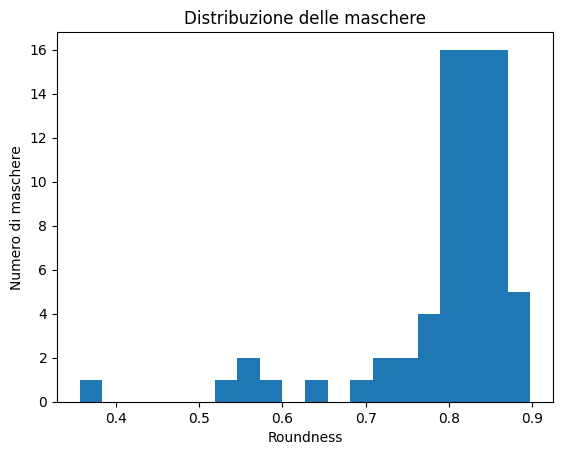

In [ ]:
areas = [mask["roundness"] for mask in roundeness_masks]
import matplotlib.pyplot as plt

plt.hist(areas, bins=20)
plt.xlabel("Roundness")
plt.ylabel("Numero di maschere")
plt.title("Distribuzione delle maschere")
plt.show()

In [ ]:
def filter_masks_by_roundness(roundeness_masks, min_roundness, max_roundness):
  """
  Filters masks based on a given roundness range.
  Returns a list of masks that have roundness within the specified range.
  """
  return [
      mask_entry for mask_entry in roundeness_masks
      if mask_entry.get('roundness') is not None and min_roundness <= mask_entry['roundness'] <= max_roundness
  ]

In [ ]:
min_roundness=0.7
max_roundness=0.9

filtered_roundeness_masks = filter_masks_by_roundness(roundeness_masks, min_roundness, max_roundness)

# Stampa il numero di maschere rimaste dopo il filtro per reoundness
print(f"Maschere dopo il filtro per roundness: {len(filtered_roundeness_masks)}")

Maschere dopo il filtro per roundness: 61


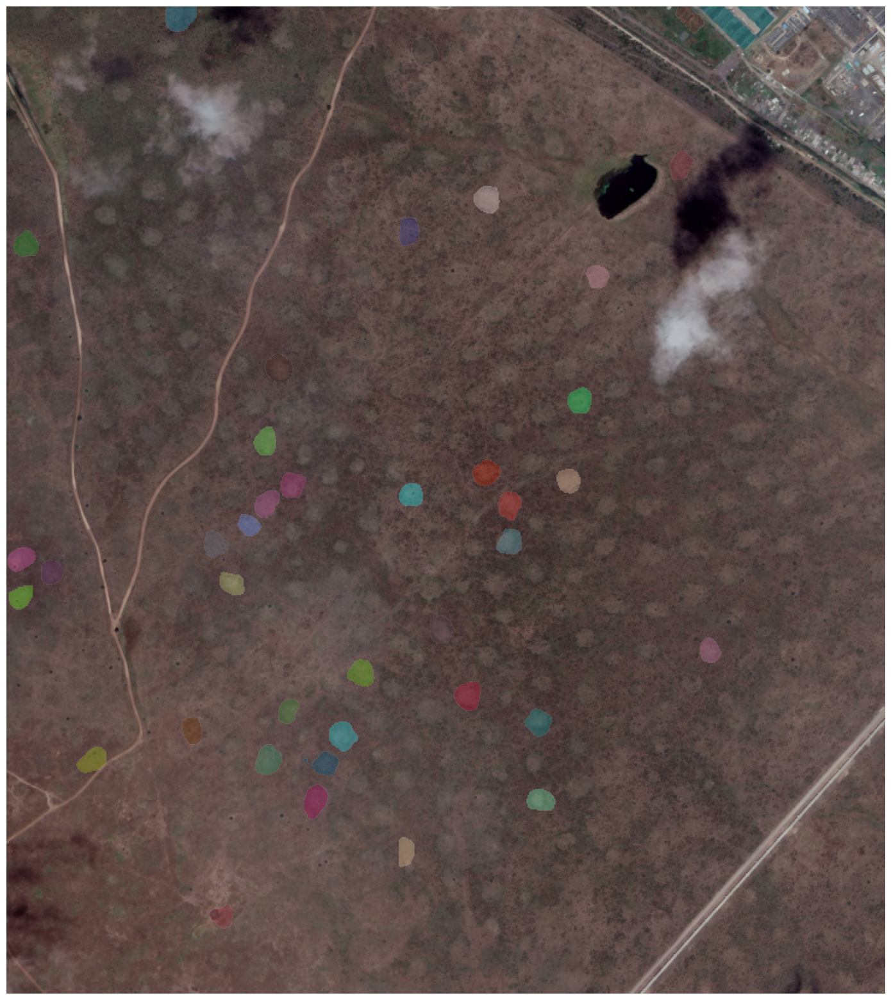

In [ ]:
plt.figure(figsize=(20,20))
plt.imshow(image_resized)
show_anns(filtered_roundeness_masks)
plt.axis('off')
plt.show()

# Eccentricity


Misura quanto una forma è allungata rispetto a un’ellisse.
Viene calcolata come l’eccentricità dell’ellisse che approssima la forma.

Valore = 0 → cerchio perfetto.

Valore vicino a 1 → forma molto allungata.


Non dipende dalla complessità del bordo, ma dalla distribuzione spaziale dei pixel bianchi.

In [ ]:
def compute_eccentricity(mask):
    """
    Compute the eccentricity of the white region in a binary mask.
    """
    # Convert boolean mask to uint8 (0 and 255)
    mask = mask.astype(np.uint8) * 255
    _, binary = cv2.threshold(mask, 127, 255, cv2.THRESH_BINARY)

    # Find contours
    contours, _ = cv2.findContours(binary, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    if len(contours) == 0:
        return None  # No object found

    # Find the largest contour
    largest_contour = max(contours, key=cv2.contourArea)

    # Fit an ellipse to the largest contour (requires at least 5 points)
    if len(largest_contour) < 5:
        return None

    ellipse = cv2.fitEllipse(largest_contour)
    (center, axes, angle) = ellipse
    major_axis = max(axes)
    minor_axis = min(axes)

    if major_axis == 0:
        return None  # Avoid division by zero

    # Compute eccentricity: sqrt(1 - (b^2 / a^2))
    eccentricity = np.sqrt(1 - (minor_axis ** 2) / (major_axis ** 2))
    return eccentricity

def add_eccentricity_to_masks(masks):
    """
    Adds the computed eccentricity to each mask dictionary entry in masks.
    """
    for mask_entry in masks:
        mask = mask_entry['segmentation']  # Assuming this is a numpy array
        eccentricity = compute_eccentricity(mask)
        mask_entry['eccentricity'] = eccentricity  # Store eccentricity in the dictionary

    return masks

def filter_masks_by_eccentricity(eccentricity_masks, eccentricity_trashold=0.5):
  """
  Filters masks based on a given roundness range.
  Returns a list of masks that have roundness within the specified range.
  """
  return [
      mask_entry for mask_entry in eccentricity_masks
      if mask_entry.get('eccentricity') is not None and mask_entry['eccentricity'] <= eccentricity_trashold
  ]


In [ ]:
# Add eccentricity to masks
eccentricity_masks = add_eccentricity_to_masks(filtered_roundeness_masks)

# Apply Eccentricity filter
filtered_eccentricity_masks = filter_masks_by_eccentricity(eccentricity_masks)

# Stampa il numero di maschere rimaste dopo il filtro per eccentricity
print(f"Maschere dopo il filtro per eccentricità: {len(filtered_eccentricity_masks)}")

Maschere dopo il filtro per roundness: 20


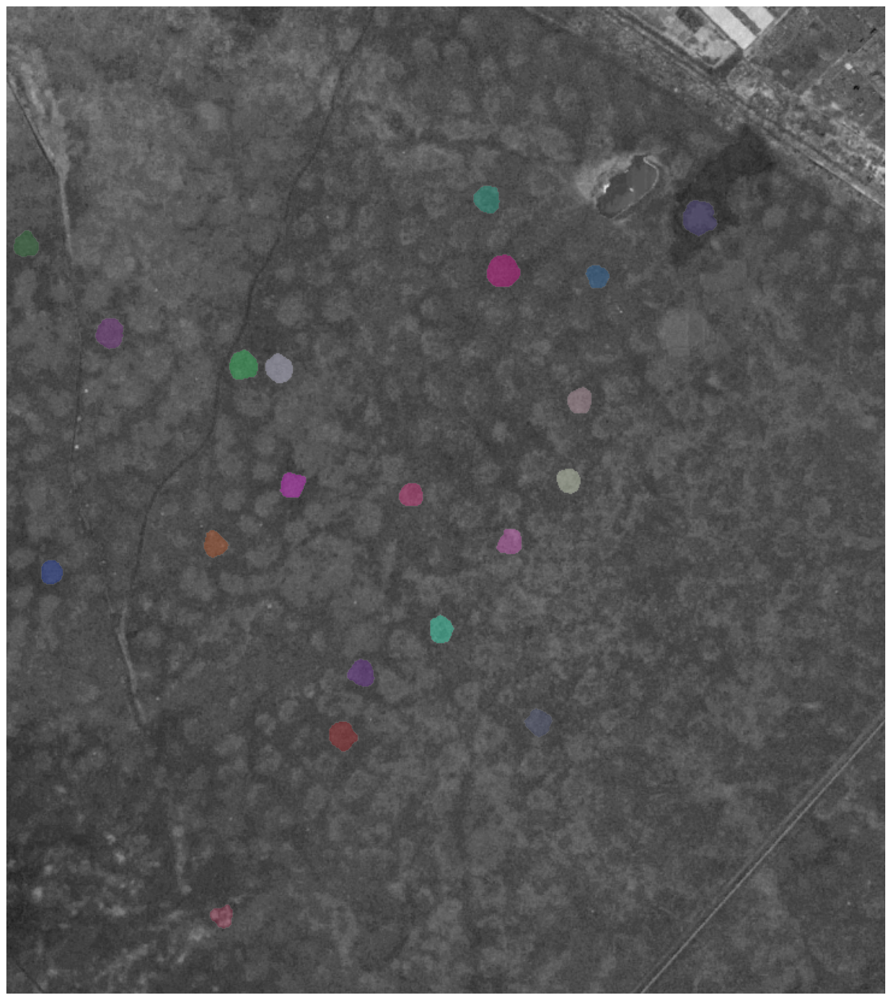

In [ ]:
plt.figure(figsize=(20,20))
plt.imshow(image_resized)
show_anns(filtered_eccentricity_masks)
plt.axis('off')
plt.show()

#Eccentricity vs Roundness

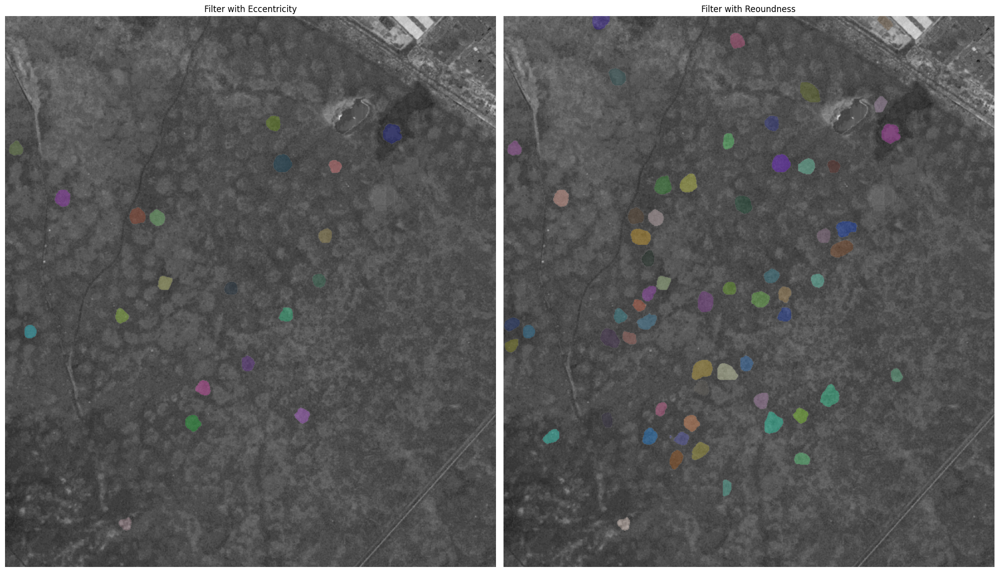

In [ ]:
# Visualizzazione affiancata
fig, axs = plt.subplots(1, 2, figsize=(20, 20))

# SINISTRA: area in pixel
plt.sca(axs[0])
axs[0].imshow(image_resized)
show_anns(filtered_eccentricity_masks)
axs[0].axis('off')
axs[0].set_title("Filter with Eccentricity")

# DESTRA: area in m²
plt.sca(axs[1])
axs[1].imshow(image_resized)
show_anns(filtered_roundeness_masks)
axs[1].axis('off')
axs[1].set_title("Filter with Reoundness")

plt.tight_layout()
plt.show()

#Masks Save

In [ ]:
import pickle

with open('masks_exg_filtered.pkl', 'wb') as f:
    pickle.dump(filtered_roundeness_masks, f)

In [ ]:
import pickle

with open('masks_exg_filtered_ecc.pkl', 'wb') as f:
    pickle.dump(filtered_eccentricity_masks, f)